#  Who do I bet on?: Insights from machine learning into French Trot horse racing.

By Kevin Tawadros and Emiliano Jimenez Guadarrama, for the *2023 French Trot Horse Racing Competition* of *CANSSI Ontario*.

## Introduction
French Trot racing is a specific type of horse racing in which horses race at a specific gait, called trot. There are two types of races Trotting and Trotting monte, a maximum of 18 horses per race and 7 winning positions in which the horse will win a reward. For this competition we were given a dataset of 1200412 entries and 43 columns.

We decided to approach this dataset with a question in mind. If we had money to bet on a french trot race, who will we bet on?

Well the answer to this question is a horse that wins the race or at least wins enough money so that we dont lose ours. But this is not information we can obtain before the race so we will try to shed some light on this question with machine learning.

Probability in it's begining was used to shed some lights on the misteries of gambling we will return to this endeavor that sparked human inovation once agin, using maching learning.

**The following tools were used in this project:**

In [223]:
import sklearn
import numpy as np
from scipy import stats
import pandas as pd
import altair as alt
import re
from statsmodels.stats.outliers_influence import variance_inflation_factor 
from sklearn.decomposition import PCA
import matplotlib.pyplot as plot
import tensorflow as tf
from sklearn import metrics
import scikitplot as skplt

*The use of some of them has been removed from the final presentation of this report as in some cases they were only used to gain insight.*

In [259]:
import warnings
warnings.filterwarnings("ignore")

## Exploratory analysis 

In [226]:
fullData=pd.read_parquet('trots_2013-2022.parquet', engine='pyarrow')
fullData.shape

(1200412, 43)

In [227]:
fullData.head()

,AgeRestriction,Barrier,BeatenMargin,ClassRestriction,CourseIndicator,DamID,Disqualified,Distance,FinishPosition,FoalingCountry,...,StartType,StartingLine,Surface,TrackID,TrainerID,NoFrontCover,PositionInRunning,WideOffRail,WeightCarried,WetnessScale
0,6yo,5,1.55,NW$101 CD,,1491946,False,2150.0,2,FR,...,M,1,S,951,38190,-9,-9,-9,0.0,3
1,6yo,6,3.55,NW$101 CD,,1509392,False,2150.0,4,FR,...,M,1,S,951,38432,-9,-9,-9,0.0,3
2,6yo,7,5.55,NW$101 CD,,1507967,False,2150.0,6,FR,...,M,1,S,951,37826,-9,-9,-9,0.0,3
3,6yo,8,999.00,NW$101 CD,,1508536,False,2150.0,BS,FR,...,M,1,S,951,38293,-9,-9,-9,0.0,3
4,6yo,9,999.00,NW$101 CD,,1514055,False,2150.0,BS,FR,...,M,2,S,951,38945,-9,-9,-9,0.0,3


In [224]:
fullData.columns

Index(['AgeRestriction', 'Barrier', 'BeatenMargin', 'ClassRestriction',
       'CourseIndicator', 'DamID', 'Disqualified', 'Distance',
       'FinishPosition', 'FoalingCountry', 'FoalingDate', 'FrontShoes',
       'Gender', 'GoingAbbrev', 'GoingID', 'HandicapDistance', 'HandicapType',
       'HindShoes', 'HorseAge', 'HorseID', 'JockeyID', 'PIRPosition',
       'PriceSP', 'Prizemoney', 'RaceGroup', 'RaceID', 'RaceOverallTime',
       'RacePrizemoney', 'RaceStartTime', 'RacingSubType', 'Saddlecloth',
       'SexRestriction', 'SireID', 'StartType', 'StartingLine', 'Surface',
       'TrackID', 'TrainerID', 'NoFrontCover', 'PositionInRunning',
       'WideOffRail', 'WeightCarried', 'WetnessScale'],
      dtype='object')

In [228]:
fullData['ClassRestriction'].unique()

array(['NW$101 CD', 'NW$75 CE', 'NW$165 CF', ..., 'NW$223', 'NW$273 CND',
       'NW$178 CND CD'], dtype=object)

In [230]:
fullData['FinishPosition'].unique()

array(['2  ', '4  ', '6  ', 'BS ', '7  ', '10 ', 'UN ', '1  ', '3  ',
       '11 ', '12 ', '13 ', '5  ', '8  ', '9  ', '14 ', 'DQ ', 'PU ',
       '16 ', '15 ', 'NP ', '17 ', 'FL ', '18 ', 'UR ', 'WC '],
      dtype=object)

In [231]:
fullData['GoingAbbrev'].unique()

array(['G  ', 'SO ', 'H  ', 'U  ', 'VF '], dtype=object)

In [232]:
fullData['PIRPosition'].unique()

array([ 0,  6,  4,  3,  1,  5,  7,  2, 13, 12, 11,  8,  9, 10, 14, 17, 21,
       19, 15, 16, 18, 25, 23, 24, 20, 22, 26])

In [233]:
fullData['CourseIndicator'].unique()

array([' ', 'G', 'P', '&'], dtype=object)

#### Discussion
As noticed by the code results above jupyter notebook can not show us all the columns and it's values even when we use the head method. That's why we investigated the values and column names of the non self explanatory columns our results are as follows. *It's important to note we did not get conclusive information in certain cases.*

* FoalingCountry = Birth country of the horse
* FoalingDate = Birth date of the horse
* DamID = Horse mother id
* SireID = Identification number required by law for french born horses (or the father of the horse ID)
* PIRPosition = Position at the start of the race
* FinishPosition = The poistion in which they finished or
    * BS = Break Stride
    * PU = Pulled Up
    * FL = Fell
    * NP = Took no Part
* RacingSubType =
    * T = Trotting: Standard Trotting
    * TM = Trotting Monte: When the driver rides the horse rather than the buggy.
* Surface (our supposition)
    * T = turf which is the same as grass
    * S = sand
    * C = cinder
* StartType (our supposition)
    * M = mobile start (horse behind a car)
    * V = volte start (horse is walking)
* CourseIndicator (our supposition)
    * G = grande piste
    * P = petite piste
    * '' = unknown
    * & = unknown
* Saddlecloth = We believe this could be the weight of the saddle
* GoinGabbrev = We do not know what this stands for
* SexRestriction
    * F = female
    * M = male
    * '' = no restriction
    * C&G = We did not find any conclusive information about this value, we suspect it might be Cryptorchidism (a horse with one testicle)



## Preprocessing

In this section we did the following:

* Removed extra whiteSpace in the whole data set
* Transform categorical data into numerical data
* Divide the dataset into subdatasets including training and testing

### Creation of useful datasets

Position indicates from which dataframe it was created.

We decided to divide the dataset into the values that we have before the race starts (beforeRace) and the ones we get after the race starts (afterRace). Then we further divide the datasets into training and test datasets. Our training dataset stops at the race before 1 November 2021, and our test set start at the race of 1 November 2021.

**Notice that our test sets just contain the FinishPosition column as that's the only one in which we are interested for the sake of our prediction**

* fullData
    * fullDataSorted
    * rawFullData (copy of fullDataSorted)
        * beforeRace
            * beforeRaceTraining
            * beforeRaceTest
        * afterRace
            * afterRaceTraining
            * afterRaceTest
        * fullDataTest
        * fullDataTraining


In [ ]:
fullDataSorted = fullData.sort_values(by='RaceStartTime').reset_index(drop=True)

In [24]:
def remove_whitespace(cell):
    if isinstance(cell, str):
        return cell.strip()
    else:
        return cell

In [25]:
fullDataSorted = fullDataSorted.applymap(remove_whitespace)

In [27]:
# Test
fullDataSorted[fullDataSorted['FinishPosition']=='PU ']

,AgeRestriction,Barrier,BeatenMargin,ClassRestriction,CourseIndicator,DamID,Disqualified,Distance,FinishPosition,FoalingCountry,...,StartType,StartingLine,Surface,TrackID,TrainerID,NoFrontCover,PositionInRunning,WideOffRail,WeightCarried,WetnessScale


In [28]:
fullDataSorted[fullDataSorted['FinishPosition']=='PU']

,AgeRestriction,Barrier,BeatenMargin,ClassRestriction,CourseIndicator,DamID,Disqualified,Distance,FinishPosition,FoalingCountry,...,StartType,StartingLine,Surface,TrackID,TrainerID,NoFrontCover,PositionInRunning,WideOffRail,WeightCarried,WetnessScale
329,3yo,0,999.0,NW$17 CE,,1521336,False,2850.0,PU,FR,...,V,-1,S,1896,39205,-9,-9,-9,60.0,3
1475,5yo,0,999.0,NW$55 CF,,1497121,False,2850.0,PU,FR,...,V,-1,C,987,38737,-9,-9,-9,0.0,3
1507,4yo,0,999.0,NW$28 CF,,1478585,False,3000.0,PU,FR,...,V,-1,S,1005,38308,-9,-9,-9,0.0,3
1704,5yo,0,999.0,NW$92 CE,,1495272,False,2725.0,PU,FR,...,V,-1,C,1916,39475,-9,-9,-9,0.0,3
2146,5&6yo,0,999.0,NW$82 CE,,1479677,False,2850.0,PU,FR,...,V,-1,S,1896,38916,-9,-9,-9,67.0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1199248,4yo,0,999.0,CG,,1483890,False,2625.0,PU,FR,...,V,-1,S,906,37807,-9,-9,-9,0.0,3
1199706,6-9yo,0,999.0,NW$89 CF,,1540006,False,2625.0,PU,FR,...,V,-1,S,906,38958,-9,-9,-9,0.0,3
1199906,5yo,0,999.0,NW$90,G,1509190,False,2700.0,PU,FR,...,V,-1,C,1969,37962,-9,-9,-9,0.0,3
1199926,4yo,0,999.0,NW$52 CB,G,1483259,False,2700.0,PU,FR,...,V,-1,C,1969,38254,-9,-9,-9,0.0,3


#### Transform Categorical Data to numerical

In [31]:
rawFullData = fullDataSorted.copy()

In [32]:
categoricalColumns = ["Gender","StartType", "CourseIndicator",
                      "FoalingCountry", "StartType", "Surface",
                      "RacingSubType", "SexRestriction", "HandicapType",
                      "ClassRestriction", "GoingAbbrev",
                     "Saddlecloth", "RaceGroup"]
for column in categoricalColumns:
    fullDataSorted[column] = pd.factorize(fullDataSorted[column])[0]

In [36]:
fullDataSorted['Gender'].unique()

array([0, 1])

In [38]:
fullDataSorted['AgeRestriction'].unique()

array(['3yo', '4yo', '6yo', '5yo', '2yo', '5-9yo', '7-9yo', '5-10yo',
       '6-9yo', '7-10yo', '6&7yo', '7&8yo', '6-10yo', '6-8yo', '4&5yo',
       '5&6yo', '5-7yo', '7yo', '4-9yo', '', '8-10yo', '4-7yo', '8&9yo',
       '4-10yo', '5-8yo', '4-6yo', '4-8yo', '3-5yo', '6yo+', '8yo+',
       '4yo+', '5yo+', '3yo+', 9, '7yo+', '9&10yo', '3-10yo', '8yo'],
      dtype=object)

In [37]:
fullDataSorted['AgeRestriction']=fullDataSorted['AgeRestriction'].replace('Pour 9',9)

In [39]:
def get_first_digit_plus(x):
    if ((isinstance(x, str)) and (len(x)==4)):
        match = re.search(r'(\d)yo\+', x)
        if match:
            return int(x[0])
        else:
            return x
    else:
        return x

fullDataSorted['AgeRestriction'] = fullDataSorted['AgeRestriction'].apply(get_first_digit_plus)

In [40]:
def get_first_digit(x):
    if ((isinstance(x, str)) and (len(x)==3)):
        match = re.search(r'(\d)yo', x)
        if match:
            return int(x[0])
        else:
            return x
    else:
        return x

fullDataSorted['AgeRestriction'] = fullDataSorted['AgeRestriction'].apply(get_first_digit)

In [41]:
fullDataSorted['AgeRestriction'].unique()

array([3, 4, 6, 5, 2, '5-9yo', '7-9yo', '5-10yo', '6-9yo', '7-10yo',
       '6&7yo', '7&8yo', '6-10yo', '6-8yo', '4&5yo', '5&6yo', '5-7yo', 7,
       '4-9yo', '', '8-10yo', '4-7yo', '8&9yo', '4-10yo', '5-8yo',
       '4-6yo', '4-8yo', '3-5yo', 8, 9, '9&10yo', '3-10yo'], dtype=object)

In [42]:
def get_mean_usingLine(x):
    if ((isinstance(x, str)) and (len(x)==5)):
        match = re.search(r'(\d+)-(\d+)yo', x)
        if match:
            val1=int(x[0])
            val2=int(x[2])
            mean=(val2-val1)/2
            return val1 + mean
        else:
            return x
    else:
        return x

fullDataSorted['AgeRestriction'] = fullDataSorted['AgeRestriction'].apply(get_mean_usingLine)

In [44]:
fullDataSorted['AgeRestriction'].unique()

array([3, 4, 6, 5, 2, 7.0, 8.0, '5-10yo', 7.5, '7-10yo', '6&7yo', '7&8yo',
       '6-10yo', '4&5yo', '5&6yo', 6.5, '', '8-10yo', 5.5, '8&9yo',
       '4-10yo', 9, '9&10yo', '3-10yo'], dtype=object)

In [45]:
fullDataSorted['AgeRestriction']=fullDataSorted['AgeRestriction'].replace('5-10yo',7.5)

In [46]:
fullDataSorted['AgeRestriction']=fullDataSorted['AgeRestriction'].replace('8-10yo',9)

In [47]:
fullDataSorted['AgeRestriction']=fullDataSorted['AgeRestriction'].replace('7-10yo',8.5)

In [48]:
fullDataSorted['AgeRestriction']=fullDataSorted['AgeRestriction'].replace('6-10yo',2)

In [49]:
fullDataSorted['AgeRestriction']=fullDataSorted['AgeRestriction'].replace('4-10yo',7)

In [50]:
fullDataSorted['AgeRestriction']=fullDataSorted['AgeRestriction'].replace('3-10yo',6.5)

In [51]:
fullDataSorted['AgeRestriction'].unique()

array([3, 4, 6, 5, 2, 7.0, 8.0, 7.5, 8.5, '6&7yo', '7&8yo', '4&5yo',
       '5&6yo', 6.5, '', 9, 5.5, '8&9yo', '9&10yo'], dtype=object)

In [52]:
def get_mean_usingAmper(x):
    if ((isinstance(x, str)) and (len(x)==5)):
        match = re.search(r'(\d+)&(\d+)yo', x)
        if match:
            val1=int(x[0])
            val2=int(x[2])
            mean=(val2-val1)/2
            return val1 + mean
        else:
            return x
    else:
        return x

fullDataSorted['AgeRestriction'] = fullDataSorted['AgeRestriction'].apply(get_mean_usingAmper)

In [53]:
fullDataSorted['AgeRestriction'].unique()

array([3, 4, 6, 5, 2, 7.0, 8.0, 7.5, 8.5, 6.5, 4.5, 5.5, '', 9, '9&10yo'],
      dtype=object)

In [54]:
fullDataSorted['AgeRestriction']=fullDataSorted['AgeRestriction'].replace('9&10yo',9.5)

In [55]:
fullDataSorted['AgeRestriction'].unique()

array([3, 4, 6, 5, 2, 7.0, 8.0, 7.5, 8.5, 6.5, 4.5, 5.5, '', 9, 9.5],
      dtype=object)

**Apparently the max age restriction for a horse age is 14, so whenever the race has an age restriction of at least a certain number we will take the mean between the starting age and 14**

In [56]:
fullDataSorted['AgeRestriction']=fullDataSorted['AgeRestriction'].replace('',14)

In [57]:
fullDataSorted['AgeRestriction'].unique()

array([ 3. ,  4. ,  6. ,  5. ,  2. ,  7. ,  8. ,  7.5,  8.5,  6.5,  4.5,
        5.5, 14. ,  9. ,  9.5])

In [58]:
fullDataSorted['FinishPosition'] = np.where(fullDataSorted["FinishPosition"].str.isnumeric(),
                                                  fullDataSorted["FinishPosition"], "19")
rawFullData['FinishPosition'] = np.where(rawFullData["FinishPosition"].str.isnumeric(),
                                                  rawFullData["FinishPosition"], "19")
fullDataSorted['FinishPosition'] = pd.to_numeric(fullDataSorted["FinishPosition"], errors='ignore')
rawFullData['FinishPosition'] = pd.to_numeric(rawFullData["FinishPosition"], errors='ignore')

In [59]:
fullDataTraining=fullDataSorted.iloc[:1160851,:].copy()
fullDataTest=fullDataSorted.iloc[1160851:,:].copy()

In [60]:
beforeRace = fullDataSorted[['AgeRestriction', 'Barrier', 'ClassRestriction', 'CourseIndicator', 'DamID', 'Distance',
    'FoalingCountry', 'FoalingDate', 'FrontShoes', 'Gender', 'GoingAbbrev', 'GoingID',
    'HandicapDistance', 'HandicapType', 'HindShoes', 'HorseAge', 'HorseID', 'JockeyID',
    'RaceGroup', 'RaceID', 'RacePrizemoney', 'RaceStartTime', 'RacingSubType', 'Saddlecloth',
    'SexRestriction', 'SireID', 'StartType', 'StartingLine', 'Surface', 'TrackID', 'TrainerID',
    'WeightCarried', 'WetnessScale']].copy()

In [61]:
beforeRace.shape

(1200412, 33)

afterRace = fullData[[
    'BeatenMargin', 'Disqualified', 'FinishPosition', 'PIRPosition', 'Prizemoney', 'RaceOverallTime',
    'PriceSP', 'NoFrontCover', 'PositionInRunning', 'WideOffRail'
]].copy()

In [62]:
afterRace=fullDataSorted[['FinishPosition']].copy()
afterRace

,FinishPosition
0,1
1,3
2,4
3,5
4,6
...,...
1200407,19
1200408,5
1200409,2
1200410,3


In [63]:
beforeRace['RaceStartTime'].min()

Timestamp('2013-12-09 12:30:00')

In [64]:
beforeRace['RaceStartTime'].idxmin()

0

In [65]:
beforeRace['RaceStartTime'].max()

Timestamp('2022-02-10 17:59:00')

In [66]:
beforeRace['RaceStartTime'].idxmax()

1200402

In [256]:
beforeRace.dtypes

AgeRestriction             float64
Barrier                      int64
ClassRestriction             int64
CourseIndicator              int64
DamID                        int64
Distance                   float64
FoalingCountry               int64
FoalingDate         datetime64[ns]
FrontShoes                   int64
Gender                       int64
GoingAbbrev                  int64
GoingID                      int64
HandicapDistance           float64
HandicapType                 int64
HindShoes                    int64
HorseAge                     int64
HorseID                      int64
JockeyID                     int64
RaceGroup                    int64
RaceID                       int64
RacePrizemoney             float64
RaceStartTime       datetime64[ns]
RacingSubType                int64
Saddlecloth                  int64
SexRestriction               int64
SireID                       int64
StartType                    int64
StartingLine                 int64
Surface             

In [68]:
dates=beforeRace[['RaceStartTime']]

In [69]:
filtered_rows = dates[dates['RaceStartTime'].dt.strftime('%Y-%m-%d').str.startswith('2021-10-01')]
filtered_rows

,RaceStartTime
1160851,2021-10-01 16:27:00
1160852,2021-10-01 16:27:00
1160853,2021-10-01 16:27:00
1160854,2021-10-01 16:27:00
1160855,2021-10-01 16:27:00
...,...
1161145,2021-10-01 22:11:00
1161146,2021-10-01 22:11:00
1161147,2021-10-01 22:11:00
1161148,2021-10-01 22:11:00


In [70]:
place_to_divide = dates[dates['RaceStartTime'].dt.strftime('%Y-%m-%d').str.startswith('2021-10-01')]
place_to_divide

,RaceStartTime
1160851,2021-10-01 16:27:00
1160852,2021-10-01 16:27:00
1160853,2021-10-01 16:27:00
1160854,2021-10-01 16:27:00
1160855,2021-10-01 16:27:00
...,...
1161145,2021-10-01 22:11:00
1161146,2021-10-01 22:11:00
1161147,2021-10-01 22:11:00
1161148,2021-10-01 22:11:00


In [71]:
dates.iloc[1160850:1160851,:]

,RaceStartTime
1160850,2021-09-30 20:19:00


In [72]:
beforeRaceTraining=beforeRace.iloc[:1160851,:].copy()
beforeRaceTraining[['RaceStartTime']]

,RaceStartTime
0,2013-12-09 12:30:00
1,2013-12-09 12:30:00
2,2013-12-09 12:30:00
3,2013-12-09 12:30:00
4,2013-12-09 12:30:00
...,...
1160846,2021-09-30 20:19:00
1160847,2021-09-30 20:19:00
1160848,2021-09-30 20:19:00
1160849,2021-09-30 20:19:00


In [237]:
beforeRaceTest=beforeRace.iloc[1160851:,:].copy()

In [235]:
afterRaceTraining=afterRace.iloc[:1160851,:].copy()

In [234]:
afterRaceTest=afterRace.iloc[1160851:,:].copy()

In [76]:
rawFullData.FinishPosition.unique()
rawFullData.FinishPosition.isin(['FL','NP','DQ','UN','PU','FL','NP', 'WC'])

0          False
1          False
2          False
3          False
4          False
           ...  
1200407    False
1200408    False
1200409    False
1200410    False
1200411    False
Name: FinishPosition, Length: 1200412, dtype: bool

In [77]:
win = rawFullData[rawFullData.FinishPosition < 4]

## Exploratory Analysis Visualisation

We explored the dataset to find the most important factors in making a horse a wining horse. We labeled them with useful or not useful, to aid us in our search for an accurate predictive model.

In [78]:
## useful
alt.Chart(rawFullData[0:5000]).encode(
    x='FoalingCountry:N',
    y='mean(FinishPosition)'
).mark_bar()

alt.Chart(...)

In [79]:
## not useful

alt.Chart(win[0:5000]).encode(
    x=alt.X('HorseID').scale(zero=False),
    y='AgeRestriction',
    color = "FinishPosition:N"
).mark_circle()

alt.Chart(...)

In [80]:
## useful?

alt.Chart(win[0:5000]).encode(
    x=alt.X('HorseID').scale(zero=False),
    y='HorseAge',
    color = "FinishPosition:N"
).mark_circle()

alt.Chart(...)

In [81]:
## not useful
alt.Chart(win[0:5000]).encode(
    x=alt.X('HorseID').scale(zero=False),
    y='RacingSubType',
    color = "FinishPosition:N"
).mark_circle()

alt.Chart(...)

In [82]:
## not useful
alt.Chart(rawFullData[0:5000]).encode(
    x='Gender:N',
    y='mean(FinishPosition)'
).mark_bar()

alt.Chart(...)

In [83]:
## not useful
alt.Chart(win[0:5000]).encode(
    x=alt.X('HorseID').scale(zero=False),
    y='StartType',
    color = "FinishPosition:N"
).mark_circle()

alt.Chart(...)

In [84]:
cormat = fullDataSorted[['AgeRestriction', 'Barrier', 'ClassRestriction', 'CourseIndicator', 'DamID', 'Distance',
    'FoalingCountry', 'FrontShoes', 'Gender', 'GoingAbbrev', 'GoingID',
    'HandicapDistance', 'HandicapType', 'HindShoes', 'HorseAge', 'HorseID', 'JockeyID',
    'RaceGroup', 'RaceID', 'RacePrizemoney', 'RaceStartTime', 'RacingSubType', 'Saddlecloth',
    'SexRestriction', 'SireID', 'StartType', 'StartingLine', 'Surface', 'TrackID', 'TrainerID',
    'WeightCarried', 'WetnessScale', "FinishPosition"]].corr()

cormat_tidy = cormat.stack().reset_index().rename(columns={0: 'corr'})


# fullDataSorted.dtypes

In [260]:
cormat_tidy[cormat_tidy.level_0 == "FinishPosition"][cormat_tidy["corr"].abs() >0.01]

,level_0,level_1,corr
1058,FinishPosition,ClassRestriction,-0.013415
1061,FinishPosition,Distance,0.011566
1062,FinishPosition,FoalingCountry,-0.010588
1063,FinishPosition,FrontShoes,-0.012507
1064,FinishPosition,Gender,0.018761
1067,FinishPosition,HandicapDistance,-0.030323
1068,FinishPosition,HandicapType,0.010328
1071,FinishPosition,HorseID,-0.026057
1072,FinishPosition,JockeyID,0.040260
1073,FinishPosition,RaceGroup,-0.019358


In [86]:
alt.Chart(cormat_tidy).mark_rect().encode(
    x = alt.X('level_0').axis().title(''),  # no axis label ("title")
    y = alt.Y('level_1').axis().title(''),
    color = 'corr'
).properties(
    width=500,
    height=500
)

alt.Chart(...)

# Model

The objective of our model is to determine the probability of a horse being in any of the first 7 positions as this positions will receive a prize. We decided to use Artificial Neural Network as we saw it being used in an article that we use as inspiration(ELNAZ & KHANTEYMOORI, 2008).


### Scaling Data
We scale all of the value in our set to values between 0 and 1, as this is a requirement to our model.

In [261]:
data_scaled=(beforeRace - beforeRace.mean()) / beforeRace.std()
data_scaled=(data_scaled - data_scaled.min())  / (data_scaled.max() - data_scaled.min())
data_scaled = data_scaled.astype(float)
data_scaled

boundy = 1160851

data_scaled_train =data_scaled.iloc[:boundy,:].copy()
data_scaled_test =data_scaled.iloc[boundy:,:].copy()
raceIDs_test = fullDataSorted[["RaceID"]][boundy:].reset_index()

### Detect the severity of multicollinearity

We computed the variance inflation factor to detect the severity of the multicollinearity and determine if this values are useful to our model. The columns were the VIF factor is less than 5 will be the one that will be used in our model

In [264]:
vif_data = pd.DataFrame() 
vif_data["feature"] = data_scaled_train.columns 
   
vif_data["VIF"] = [variance_inflation_factor(data_scaled_train.values, i) 
                          for i in range(len(data_scaled_train.columns))] 
  
print(vif_data)

             feature          VIF
0     AgeRestriction     8.884481
1            Barrier    11.724999
2   ClassRestriction     2.627927
3    CourseIndicator     7.178934
4              DamID     3.674844
5           Distance    20.252837
6     FoalingCountry     1.156471
7        FoalingDate   828.712696
8         FrontShoes     1.667047
9             Gender     2.473571
10       GoingAbbrev    27.128154
11           GoingID   403.147683
12  HandicapDistance    27.246272
13      HandicapType    44.742201
14         HindShoes     1.574222
15          HorseAge    81.189583
16           HorseID   260.167535
17          JockeyID     2.175221
18         RaceGroup     2.273498
19            RaceID  3816.496050
20    RacePrizemoney     3.929011
21     RaceStartTime  4282.874280
22     RacingSubType   132.493550
23       Saddlecloth     3.727323
24    SexRestriction     5.901801
25            SireID     1.789605
26         StartType    23.510905
27      StartingLine    48.031282
28           S

In [134]:
features = vif_data[(vif_data["VIF"] < 5) &  ((vif_data["feature"].isin(["DamID",
                                                                         "JockeyID", "TrainerID",
                                                                         "TrackID", "SireID",
                                                                         "FinishPosition"]) == False)) &
                 vif_data["feature"].isin(['AgeRestriction', 'Barrier', 'ClassRestriction', 'CourseIndicator', 'DamID', 'Distance',
    'FoalingCountry', 'FoalingDate', 'FrontShoes', 'Gender', 'GoingAbbrev', 'GoingID',
    'HandicapDistance', 'HandicapType', 'HindShoes', 'HorseAge', 'HorseID', 'JockeyID',
    'RaceGroup', 'RaceID', 'RacePrizemoney', 'RaceStartTime', 'RacingSubType', 'Saddlecloth',
    'SexRestriction', 'SireID', 'StartType', 'StartingLine', 'Surface', 'TrackID', 'TrainerID',
    'WeightCarried', 'WetnessScale'])]["feature"]
features

2     ClassRestriction
6       FoalingCountry
8           FrontShoes
9               Gender
14           HindShoes
18           RaceGroup
20      RacePrizemoney
23         Saddlecloth
28             Surface
Name: feature, dtype: object

In [135]:
x_sel_std = data_scaled_train[features]
x_sel_std_test = data_scaled_test[features]
x_sel_std

,ClassRestriction,FoalingCountry,FrontShoes,Gender,HindShoes,RaceGroup,RacePrizemoney,Saddlecloth,Surface
0,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.043129,0.000000,0.0
1,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.043129,0.052632,0.0
2,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.043129,0.105263,0.0
3,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.043129,0.157895,0.0
4,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.043129,0.210526,0.0
...,...,...,...,...,...,...,...,...,...
1160846,0.332293,0.0,0.666667,0.0,0.666667,0.0,0.029087,0.157895,0.5
1160847,0.332293,0.0,0.666667,0.0,0.666667,0.0,0.029087,0.105263,0.5
1160848,0.332293,0.0,0.666667,0.0,0.666667,0.0,0.029087,0.526316,0.5
1160849,0.332293,0.0,0.666667,0.0,0.666667,0.0,0.029087,0.052632,0.5


### Compute Principal component analysis (PCA)
The PCA algorithm return a matrix that explains the pattern of data.
We can observe that `PC0` and `PC1` are the columns that explain the most the behaviour of our data

                       PC0       PC1       PC2       PC3       PC4       PC5  \
ClassRestriction -0.031138 -0.000439  0.026243  0.978861 -0.199702  0.001047   
FoalingCountry   -0.002004 -0.006057 -0.000816  0.011945 -0.002441  0.004567   
FrontShoes       -0.005375  0.017307 -0.027105  0.164469  0.800115 -0.575904   
Gender            0.999416  0.007991  0.010638  0.031018 -0.002535 -0.004254   
HindShoes         0.001400  0.021060 -0.020866  0.114694  0.563683  0.817399   
RaceGroup        -0.000528 -0.029362 -0.005707 -0.005456  0.001894 -0.008858   
RacePrizemoney   -0.000582 -0.017560  0.000076  0.009908 -0.003072 -0.003910   
Saddlecloth      -0.009986  0.005714  0.998984 -0.019234  0.038633  0.001380   
Surface          -0.007925  0.998976 -0.005050 -0.004889 -0.026046 -0.007530   

                       PC6       PC7       PC8  
ClassRestriction  0.002965 -0.012894 -0.010752  
FoalingCountry    0.059639  0.997226 -0.042109  
FrontShoes       -0.005317  0.003009 -0.000170  
Gen

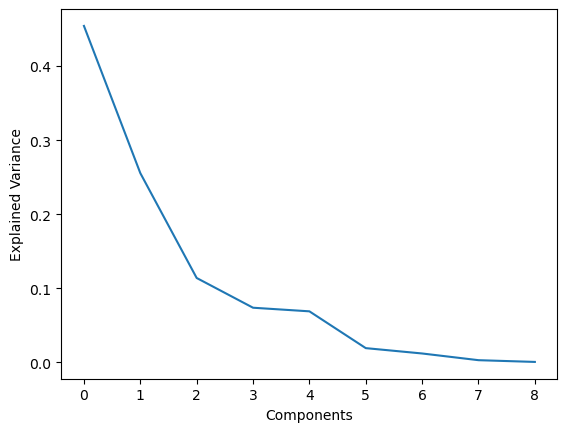

In [136]:
## source: https://stackoverflow.com/questions/23282130/principal-components-analysis-using-pandas-dataframe

pca = PCA(n_components=x_sel_std.shape[1])
pca.fit(x_sel_std)

pcas_red = pd.DataFrame(pca.components_.T,
columns=['PC%s' % _ for _ in range(len(x_sel_std.columns))],
index=x_sel_std.columns)
print(pcas_red)

plot.plot(pca.explained_variance_ratio_)
plot.ylabel('Explained Variance')
plot.xlabel('Components')
plot.show()

In [137]:
pcas_train = x_sel_std.dot(pca.components_)
pcas_test = x_sel_std_test.dot(pca.components_)
pcas_train = pcas_train.set_axis(pcas_red.columns, axis=1)
pcas_test = pcas_test.set_axis(pcas_red.columns, axis=1)
pcas

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
0,0.000142,0.002629,-0.000192,0.000052,0.000311,0.042172,0.008513,0.000246,0.001426
1,-0.000536,0.055110,-0.000052,0.000138,0.000160,0.038588,0.010042,0.000289,0.001670
2,-0.001213,0.107592,0.000088,0.000223,0.000009,0.035004,0.011571,0.000332,0.001915
3,-0.001891,0.160074,0.000228,0.000309,-0.000142,0.031419,0.013099,0.000375,0.002160
4,-0.002569,0.212555,0.000368,0.000394,-0.000292,0.027835,0.014628,0.000418,0.002404
...,...,...,...,...,...,...,...,...,...
1200407,0.007007,0.211206,0.794351,0.118428,0.600008,0.014000,0.010416,0.091521,0.000130
1200408,0.009718,0.001279,0.793791,0.118086,0.600611,0.028338,0.004301,0.091349,-0.000848
1200409,0.004296,0.421132,0.794911,0.118770,0.599406,-0.000337,0.016531,0.091694,0.001109
1200410,0.698960,0.270974,0.717334,0.149636,0.536367,0.000818,0.018949,1.068047,-0.006098


In [138]:
## Plot PCAs for one Race
pca_x_y = pd.concat([pcas.iloc[:,:2], fullDataSorted[["FinishPosition"]] <8], axis=1)
pca_x_y = pd.concat([pcas.iloc[:,:2], fullDataSorted[["FinishPosition"]] <8], axis=1)
alt.Chart(pcas_train[:30].astype(float)).encode(
    x='PC0:Q',
    y='PC1:Q',
    color = "FinishPosition:N"
).mark_circle()

alt.Chart(...)

### Split Data into Training and Testing Data using PCA

In [139]:

boundy = 1160851

train_set_x = pcas_train.iloc[:,:2]
train_set_y =afterRaceTraining[["FinishPosition"]]<8
test_set_x = pcas_test.iloc[:,:2]
test_set_y =afterRaceTest[["FinishPosition"]]<8
raceIDs_test = fullDataSorted[["RaceID"]][boundy:].reset_index()

### Training the model
We trained the model using ANN. Input layer using `sigmoid` activation function, one hidden layer using `sigmoid` activation function and output layer with 2 output using `softmax` activation function. With a dropout of 95% of neurons to avoid overfiting and attain 1 output class.

In [215]:


units = 50
model_NN_2 = tf.keras.Sequential([
    tf.keras.layers.Dense(units, input_shape=(len(train_set_x.columns),), activation='sigmoid'),
    # Add a hidden layer with dropout,
    
    tf.keras.layers.Dense(units, activation='sigmoid'),
    
    tf.keras.layers.Dropout(0.95),
    tf.keras.layers.Dense(2
                          ,activation="softmax")
])

model_NN_2.compile(optimizer='Adam', 
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

model_NN_2.fit(train_set_x,
                   train_set_y,
                    epochs=1)

36277/36277 [==============================] - 14s 370us/step - loss: 0.6955 - accuracy: 0.5103


### Testing the  Model
We got a probability for winning and losing for each horse, we now normalize the probability by race.

In [216]:
def normalize(dataframe):
    for column in dataframe.columns:
        dataframe[column] = dataframe[column] / sum(dataframe[column])
    return dataframe

In [217]:
proba = model_NN_2.predict(test_set_x)
racedataframe = pd.concat([pd.DataFrame(proba), raceIDs_test], axis=1)
predictions = racedataframe.groupby("RaceID").apply(normalize)

1237/1237 [==============================] - 0s 237us/step


In [218]:
racedataframe["winprobability"] = predictions[1].reset_index()[1]
racedataframe["WinClass"] = predictions[1].reset_index()[1] > predictions[0].reset_index()[0]
racedataframe

,0,1,index,RaceID,winprobability,WinClass
0,0.484319,0.515681,1160851,1668646,0.058938,True
1,0.486936,0.513064,1160852,1668646,0.058639,False
2,0.486143,0.513857,1160853,1668646,0.058729,False
3,0.485019,0.514981,1160854,1668646,0.058858,True
4,0.486621,0.513379,1160855,1668646,0.058675,False
...,...,...,...,...,...,...
39556,0.486595,0.513405,1200407,1710893,0.100005,True
39557,0.486378,0.513622,1200408,1710893,0.100047,True
39558,0.486764,0.513236,1200409,1710893,0.099972,False
39559,0.486509,0.513491,1200410,1710893,0.100022,True


accuracy:   0.500


<Axes: title={'center': 'Confusion Matrix'}, xlabel='Predicted label', ylabel='True label'>

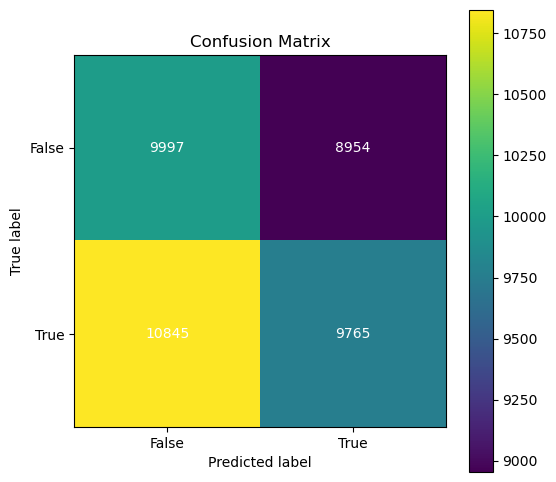

In [258]:
score = metrics.accuracy_score(test_set_y, racedataframe[["WinClass"]] * 1)
print("accuracy:   %0.3f" % score)

skplt.metrics.plot_confusion_matrix(
    test_set_y, 
    racedataframe[["WinClass"]] * 1,
    figsize=(6,6),
    cmap=plot.get_cmap('viridis')
)

### Discussion
As seen above we got an accuracy of 0.50 which can be put in context as the probability of a horse winning money is $\frac{7}{18}\approx 0.38$, we can therefore say that the model is slightly better than choosing a horse at random  since $0.50>0.38$. 

## Conclusion

Did we manage to answer the question of who should you bet on the next time you are at a racecourse? Yes we did and in doing so we manage to increse our chance of not losing money or even wining money by gambling on a certain horse. But it is important to note that this model may not be as accurate as the accuracy tells us since it is a binary classifier and an accuracy of 50% or close to 50% indicates that it is assigning a classification at random sort of like a coin toss (James, 2020). To test this hypothesis we would need more time and further testing, there are some ideas below that could aid us in this endeavor.

### Future work ideas

An idea that we did not implement due to a lack of time was to use the probabilities given by this model for each horse to update our probability on a given horse winning by using bayes theorem. 

We also thought about recognizing if a given horse is the offspring of horses that previously won a race. This might be a key piece of information as in other sports were horses are involved the bloodline of a horse is extremely important.

## References

* ELNAZ, E., &amp; KHANTEYMOORI, A. R. (2008). Horse Racing Prediction Using Artificial Neural Networks. 
* James, O. (2020, June 17). When model accuracy is 0.5. Medium. https://gmust.medium.com/when-model-accuracy-is-0-5-9aea6ff20dcc 
